# LastFM Bipartite Network
Dharma Bhattu and Collin Stratton

CST-440

Isac Artzi

1/16/2022

## Introduction
The purpose of this project is to create a bipartite network using a database from SNAP. As that bipartite networks are one of the fundamental types of networks, this project provides a good introduction to social network analysis and network theory. This document will look at the Comparison of methods for the Detection of Node Group Membership in Bipartite Networks, Levels of Aggregation, Two Node sets and Membership in a Set, as well as provide code and examples as deemed appropriate.

The data used to demonstrate data aggregation and network analysis is from the last.fm dataset. The social network LastFM collected data on their users and their followers. Nodes are users and edges are the follower relationships between users. The dataset is undirected, has over 7500 nodes, and over 25000 edges.

In [1]:
# import libraries
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# read in data
df = pd.read_csv('lastfm_asia_edges.csv', sep=',')

# create graph
G = nx.Graph()
G.add_nodes_from(df['node_1'], bipartite=0)
G.add_nodes_from(df['node_2'], bipartite=1)

# add edges
for i in range(len(df)):
    G.add_edge(df['node_1'][i], df['node_2'][i])

## Article Summary
The article starts by talking about unipartite networks and how they are well understood and transitions in the complexity of bipartite networks. These networks have two exclusive sets of nodes, and those edges run exclusively between nodes belonging to different sets. The article then follows it up with the module detection issue faced with bipartite networks and how modularity maximization and clique percolation can be used to help with. Modularity maximization is said to be the gold standard for community detection in bipartite networks. “We also find that the clique percolation methods are not capable of reliably detecting the modular bipartite structure of the bipartite model networks considered”.

## Nodes and Membership
Given a dataset with two sets of nodes, this sets the groundwork for various forms of analysis of the data. The two set node setup has the first set of nodes pointing to the second set of nodes. An example would be an actors and movies dataset, where the actors are one node set and the movies are another node set. Each actor points to one or more movies, and a graph can be generated showing the connections between the actors and the movies. This leads directly into the next section, which is the membership of the nodes in the sets. The membership of the nodes in the connection between two particular nodes. Continuing with the movie example, if two actors are connected to the same movie, then both actors are members of the same set, or node. So, two set nodes are the two sets of data that are connected to each other and membership is the connections to a particular node.

## Aggregation Levels
Aggregated data is the high-level data that is used to describe the network. The aggregation levels are the low-level data that is used to describe the network. In layman's terms, aggregated data is the collection of data and the aggregation levels are the methods used to analyze the data. These methods generally include the following: statistical and clustering analysis, and graph theory methods. The code for the aggregation levels is provided in the sections below.

### Aggregated Data of Last.fm Users and who they Follow
See below the description of the dataframe, however, not all that data is important. The describe method covers most of the basic statistical analysis, however, the dataset doesn't lend itself to being interpreted easily using basic statistical analysis.

In [2]:
df.describe()

,node_1,node_2
count,27806.000000,27806.000000
mean,2540.629073,5050.508523
std,1760.146912,1784.037694
min,0.000000,6.000000
25%,1065.000000,3715.000000
50%,2233.000000,5351.500000
75%,3738.000000,6538.000000
max,7580.000000,7623.000000


More relevant data to gather from the dataset would be the number of followers of each user, who has the most followers, the total number of connections in the dataset, etc. The next code block will output more relevant aggregated data.

In [3]:
# total number of connections
print('Total number of connections:', len(df))

# total number of users
print('Total number of users:', len(set(df['node_1'])))

# total number of followers
print('Total number of followers:', len(set(df['node_2'])))

# most followers
print('User with the most followers:', df['node_1'].value_counts().idxmax(), 'with', df['node_1'].value_counts().max(), 'followers')

Total number of connections: 27806
Total number of users: 5722
Total number of followers: 5680
User with the most followers: 524 with 164 followers


In [4]:
# followers per user
print('Followers per user:', df['node_1'].value_counts())

Followers per user: 524     164
290     101
2510    100
3530     95
3450     92
       ... 
4186      1
88        1
2121      1
72        1
0         1
Name: node_1, Length: 5722, dtype: int64


Furthermore, by creating a histogram of the users, a visual representation of the number of followers per user can be created.

array([[<AxesSubplot:title={'center':'node_1'}>]], dtype=object)

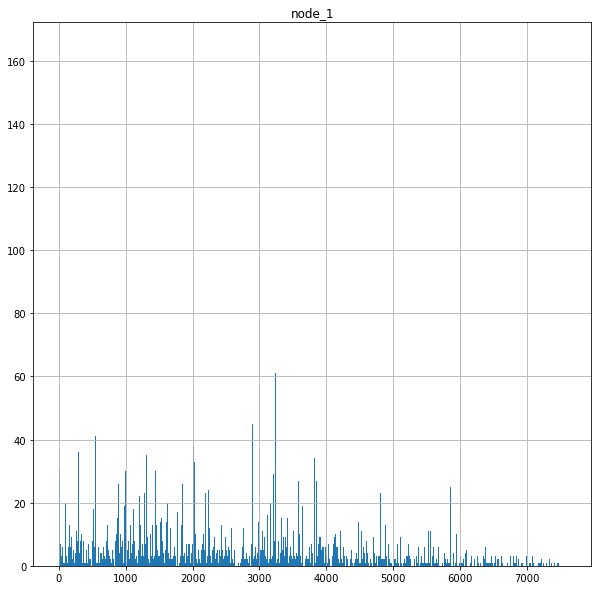

In [5]:
df.hist(column='node_1', bins=len(df['node_1'].value_counts()), figsize=(10,10))

### Bipartite Network of Last.fm Users and who they Follow
Moving on to the next section, the bipartite network of users and followers is created. Bipartite networks are graphs whose vertices can be divided into two disjoint and independent sets. In these two sets, A and B, every edge connects a vertex in A to a vertex in B. In more general terms, each node represents a subject, and the edges between the nodes connect subjects together, or rather their interaction together. The graph visualizes number of connections between users and followers using the networkx library.

In [7]:
# draw graph
plt.figure(1, figsize=(100, 100))
nx.draw(G, with_labels=True)

## Conclusion
Bipartite graphs and statistical analysis are both powerful tools for analyzing data. This project was a great introduction to the networkx library and the statistical analysis of data. While nothing is quite discernible from the bipartite graph due to its immense data size, the statistical analysis of the data is very useful, and it is visually pleasing to see. It paints a picture of the connections between users and followers, and shows how interconnected the users are.

## Resources
* https://eds-s-ebscohost-com.lopes.idm.oclc.org/eds/pdfviewer/pdfviewer?vid=1&sid=cf9958df-f0fd-43b9-85f3-5a13fd25ffc5%40redis
* https://networkx.org/documentation/latest/_downloads/networkx_reference.pdf
* https://snap.stanford.edu/data/feather-lastfm-social.html